In [1]:
import geopandas as gpd

In [1]:
import geopandas as gpd
import pandas as pd

# Load the GeoDataFrames
gdf1 = gpd.read_file('../data/raw_data/cambridge/BASEMAP_Sidewalks.shp/BASEMAP_Sidewalks.shp')
gdf2 = gpd.read_file('../data/raw_data/cambridge/BASEMAP_PublicFootpaths.shp/BASEMAP_PublicFootpaths.shp')
gdf3 = gpd.read_file('../data/raw_data/cambridge/BASEMAP_PrivateWalkways.shp/BASEMAP_PrivateWalkways.shp')
gdf4 = gpd.read_file('../data/raw_data/cambridge/BASEMAP_Plazas.shp/BASEMAP_Plazas.shp')
gdf5 = gpd.read_file('../data/raw_data/cambridge/BASEMAP_Roads.shp/BASEMAP_Roads.shp')


# Get the CRS of 'NAD83 / Massachusetts Mainland (ftUS)' from one of the GeoDataFrames (e.g., gdf1)
target_crs = gdf1.crs

# Reproject the GeoDataFrames with different CRS
gdf2 = gdf2.to_crs(target_crs)
gdf3 = gdf3.to_crs(target_crs)
gdf4 = gdf4.to_crs(target_crs)
gdf5 = gdf5.to_crs(target_crs)

# Add a new column to each GeoDataFrame with the source name
gdf1['surface_type'] = 'Sidewalks'
gdf2['surface_type'] = 'Public Footpaths'
gdf3['surface_type'] = 'Private Walkways'
gdf4['surface_type'] = 'Plazas'
gdf5['surface_type'] = 'Roads'

# Combine all GeoDataFrames into one
combined_gdf = pd.concat([gdf1, gdf2, gdf3, gdf4, gdf5], ignore_index=True)

combined_gdf = combined_gdf[['TYPE', 'surface_type', 'geometry']]
# Ensure it remains a GeoDataFrame and the geometry is properly handled
combined_gdf = gpd.GeoDataFrame(combined_gdf, geometry='geometry').reset_index()


# Now 'combined_gdf' contains all the data with the 'source' column indicating the origin

combined_gdf.to_file('../data/raw_data/cambridge/240930_cambridge_combined_surfaces.gpkg',driver='GPKG')

In [2]:
combined_gdf.head()

,index,TYPE,surface_type,geometry
0,0,SW-CONCRETE,Sidewalks,"POLYGON ((761840.791 2954067.139, 761844.490 2..."
1,1,SW-CONCRETE,Sidewalks,"POLYGON ((763015.664 2954083.947, 763004.560 2..."
2,2,SW-CONCRETE,Sidewalks,"POLYGON ((763080.340 2954095.050, 763072.130 2..."
3,3,SW-CONCRETE,Sidewalks,"POLYGON ((761474.341 2954071.321, 761465.389 2..."
4,4,SW-BITMINOUS,Sidewalks,"POLYGON ((761455.280 2954156.040, 761452.890 2..."


<Axes: >

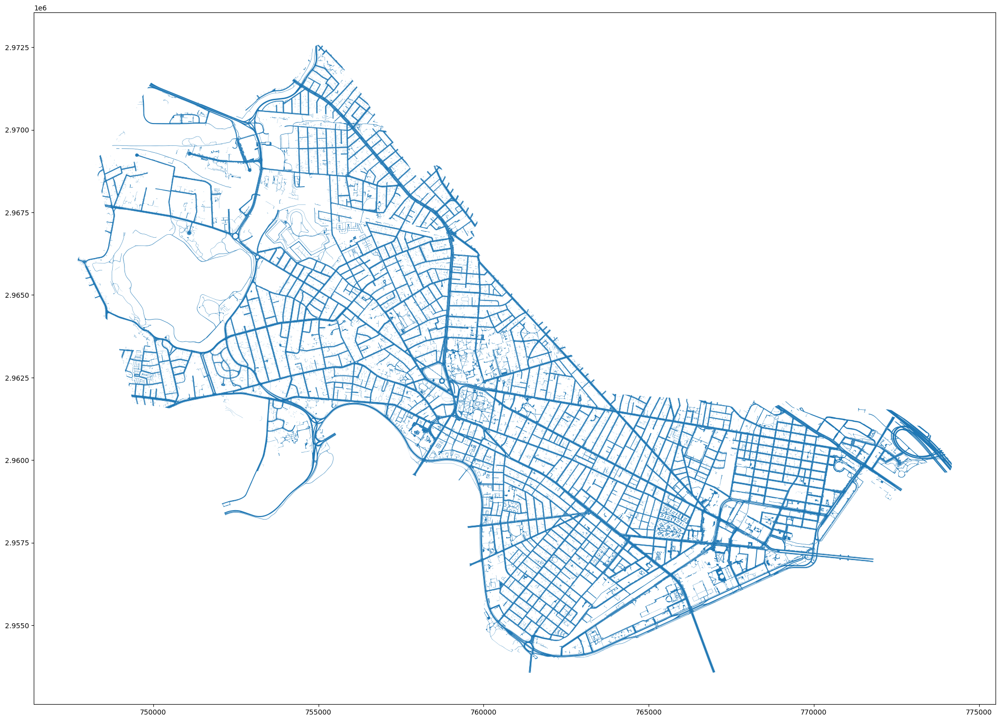

In [3]:
combined_gdf.plot(figsize=(25,25))

In [27]:
combined_gdf[0:2000].explore(column='type')

In [17]:
gdf1 = gpd.read_file('../data/raw_data/cambridge/BASEMAP_Sidewalks.shp/BASEMAP_Sidewalks.shp')
gdf1.columns

Index(['TYPE', 'EditDate', 'TREE_IN_WE', 'GRADE', 'TW_Width', 'TW_Length',
       'Shape_area', 'Shape_len', 'geometry'],
      dtype='object')

In [19]:
gdf2 = gpd.read_file('../data/raw_data/cambridge/BASEMAP_PublicFootpaths.shp/BASEMAP_PublicFootpaths.shp')
gdf2.columns

Index(['TYPE', 'EditDate', 'Shape_area', 'Shape_len', 'geometry'], dtype='object')

In [20]:
gdf3 = gpd.read_file('../data/raw_data/cambridge/BASEMAP_PrivateWalkways.shp/BASEMAP_PrivateWalkways.shp')
gdf3.columns

Index(['TYPE', 'Shape_area', 'Shape_len', 'geometry'], dtype='object')

In [21]:
gdf4 = gpd.read_file('../data/raw_data/cambridge/BASEMAP_Plazas.shp/BASEMAP_Plazas.shp')
gdf4.columns


Index(['TYPE', 'Shape_area', 'Shape_len', 'geometry'], dtype='object')

In [22]:
gdf5 = gpd.read_file('../data/raw_data/cambridge/BASEMAP_Roads.shp/BASEMAP_Roads.shp')
gdf5.columns

Index(['TYPE', 'EditDate', 'GRADE', 'created_da', 'last_edite', 'Shape_area',
       'Shape_len', 'geometry'],
      dtype='object')

In [4]:
gdf.explore()

In [16]:
m = gdf1[0:1000].explore()

gdf2[0:1000].explore(m=m, color='red')
gdf3[0:1000].explore(m=m, color='green')
gdf4[0:1000].explore(m=m, color='lime')
gdf5[0:1000].explore(m=m, color='purple')